In [ ]:
channels = 3
img_size = 64
latent_dim = 100
batch_size = 32

In [ ]:
from torch import nn

def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)


class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.init_size = img_size // 4
        self.l1 = nn.Sequential(nn.Linear(latent_dim, 128 * self.init_size ** 2))

        self.conv_blocks = nn.Sequential(
            nn.BatchNorm2d(128),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 128, 3, stride=1, padding=1),
            nn.BatchNorm2d(128, 0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 64, 3, stride=1, padding=1),
            nn.BatchNorm2d(64, 0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, channels, 3, stride=1, padding=1),
            nn.Tanh(),
        )

    def forward(self, z):
        out = self.l1(z)
        out = out.view(out.shape[0], 128, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        def discriminator_block(in_filters, out_filters, bn=True):
            block = [nn.Conv2d(in_filters, out_filters, 3, 2, 1), nn.LeakyReLU(0.2, inplace=True), nn.Dropout2d(0.25)]
            if bn:
                block.append(nn.BatchNorm2d(out_filters, 0.8))
            return block

        self.model = nn.Sequential(
            *discriminator_block(channels, 16, bn=False),
            *discriminator_block(16, 32),
            *discriminator_block(32, 64),
            *discriminator_block(64, 128),
        )

        # The height and width of downsampled image
        ds_size = img_size // 2 ** 4
        self.adv_layer = nn.Sequential(nn.Linear(128 * ds_size ** 2, 1), nn.Sigmoid())

    def forward(self, img):
        out = self.model(img)
        out = out.view(out.shape[0], -1)
        validity = self.adv_layer(out)

        return validity

In [ ]:
def move_model_to_GPU(model):
  model = nn.DataParallel(model)
  return model.to('cuda')

In [ ]:
from tqdm import tqdm
import numpy as np
import torch
from torch.autograd import Variable

cuda = torch.cuda.is_available()

Tensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor

class GAN():
    def __init__(self, cuda=True):
        self.adversarial_loss = torch.nn.BCELoss()
        self.generator = move_model_to_GPU(Generator())
        self.discriminator = move_model_to_GPU(Discriminator())

        self.optimizer_G = torch.optim.Adam(self.generator.parameters())
        self.optimizer_D = torch.optim.Adam(self.discriminator.parameters())

    def generate(self, num_gen=1):
      # Sample noise as generator input
      z = Variable(Tensor(np.random.normal(0, 1, (num_gen, latent_dim))))
      # Generate a batch of images
      gen_imgs = self.generator(z)

      return gen_imgs

    def fit(self, dataloader, callbacks=[], n_epochs=100):
        for epoch in range(n_epochs):
            print(f'Epoch {epoch}')
            bar = tqdm(dataloader)
            i = 0
            running_loss = 0.0

            data_size = len(dataloader)

            for imgs, _ in bar:
                current_batch_size = imgs.size()[0]
                # Adversarial ground truths
                valid = Variable(Tensor(imgs.size(0), 1).fill_(1.0), requires_grad=False)
                fake = Variable(Tensor(imgs.size(0), 1).fill_(0.0), requires_grad=False)

                # Configure input
                real_imgs = Variable(imgs.type(Tensor))

                # -----------------
                #  Train Generator
                # -----------------

                self.optimizer_G.zero_grad()

                # Sample noise as generator input
                z = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))

                # Generate a batch of images
                gen_imgs = self.generator(z)

                # Loss measures generator's ability to fool the discriminator
                g_loss = self.adversarial_loss(self.discriminator(gen_imgs), valid)

                g_loss.backward()
                self.optimizer_G.step()

                # ---------------------
                #  Train Discriminator
                # ---------------------

                self.optimizer_D.zero_grad()

                # Measure discriminator's ability to classify real from generated samples
                real_loss = self.adversarial_loss(self.discriminator(real_imgs), valid)
                fake_loss = self.adversarial_loss(self.discriminator(gen_imgs.detach()), fake)
                d_loss = (real_loss + fake_loss) / 2

                running_loss += d_loss.item()
                if i % 16 == 15:
                    last_loss = running_loss / current_batch_size # loss per batch
                    bar.set_description_str(f'batch {i + 1}/{data_size // current_batch_size} loss: {last_loss:.4f}')

                    running_loss = 0.

                i += 1

                d_loss.backward()
                self.optimizer_D.step()

            for callback in callbacks:
              callback(self)

In [ ]:
from torchvision.datasets import LFWPeople
import torchvision.transforms as transforms
import torch

pil_transformer = transforms.Compose([
    transforms.PILToTensor()
])

train_ds = LFWPeople('/content/drive/MyDrive', split='train', download=True,
                        image_set='original', transform=lambda pil: pil_transformer(pil.resize(
                            (img_size, img_size))) / 255)

test_ds = LFWPeople('/content/drive/MyDrive', split='test', download=True,
                       image_set='original', transform=lambda pil: pil_transformer(pil.resize(
                            (img_size, img_size))) / 255)

ds = torch.utils.data.ConcatDataset([train_ds, test_ds])
# ds = torch.utils.data.Subset(train_ds, list(range(30)))

print(len(ds))

Files already downloaded and verified
Files already downloaded and verified
13233


In [ ]:
from matplotlib import pyplot as plt
import cv2
from sklearn.preprocessing import MinMaxScaler

plot_counts = 16
num_rows = 2
num_cols = plot_counts // num_rows

save_path = '/content/drive/MyDrive/GAN/gan_cnn.torch'

def plot(net):
    images = net.generate(num_gen=plot_counts)

    _, ax = plt.subplots(num_rows, num_cols, figsize=(10, 10))

    print(f'Plotting...')
    for i, image in enumerate(images):
        cpu_image = image.detach().cpu()
        # C, H, W
        cpu_image = torch.swapaxes(cpu_image, 0, 2)
        cpu_image = torch.swapaxes(cpu_image, 0, 1).numpy()
        ori_shape = cpu_image.shape

        cpu_image = MinMaxScaler().fit_transform(cpu_image.reshape((
            cpu_image.shape[0] * cpu_image.shape[1], cpu_image.shape[2]
        ))).reshape(ori_shape)

        if num_rows == 1:
            ax[i].imshow(cpu_image)
            ax[i].axis("off")
        else:
            ax[i // num_cols, i % num_cols].imshow(cpu_image)
            ax[i // num_cols, i % num_cols].axis("off")

    plt.tight_layout()
    plt.show()

def save_model(net):
  with open(save_path, 'wb') as f:
    torch.save(net.generator.module.state_dict(), f)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 0


batch 400/12 loss: 0.1899: 100%|██████████| 414/414 [01:00<00:00,  6.79it/s]


Plotting...


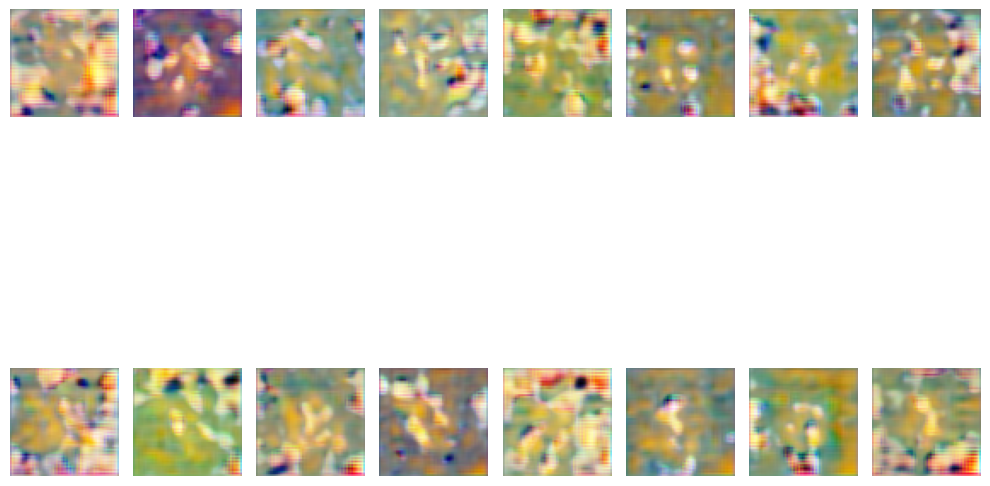

Epoch 1


batch 400/12 loss: 0.2911: 100%|██████████| 414/414 [01:02<00:00,  6.66it/s]


Plotting...


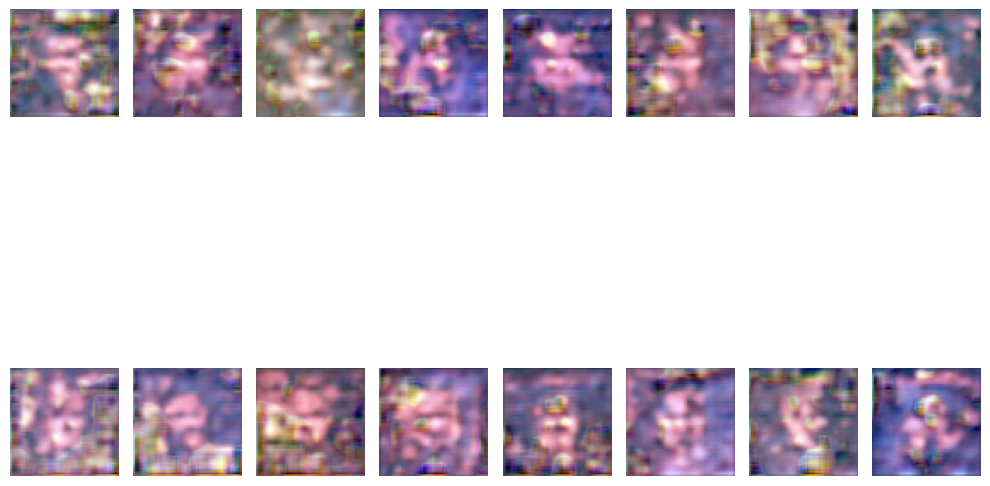

Epoch 2


batch 400/12 loss: 0.1841: 100%|██████████| 414/414 [00:59<00:00,  6.96it/s]


Plotting...


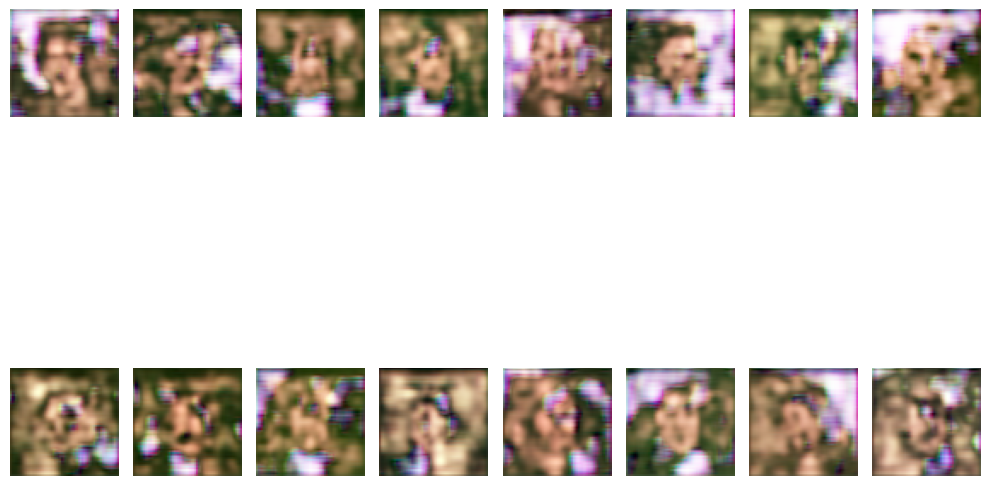

Epoch 3


batch 400/12 loss: 0.1299: 100%|██████████| 414/414 [00:53<00:00,  7.74it/s]


Plotting...


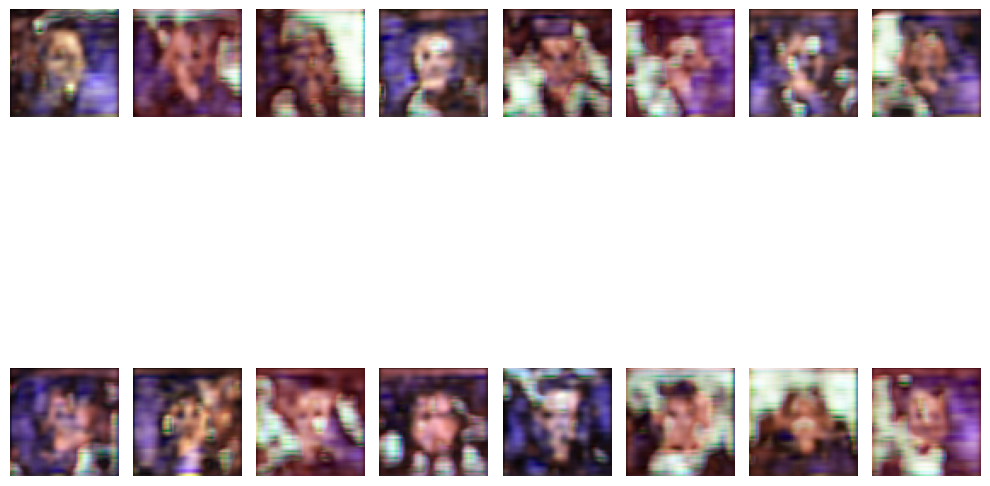

Epoch 4


batch 400/12 loss: 0.1779: 100%|██████████| 414/414 [00:52<00:00,  7.87it/s]


Plotting...


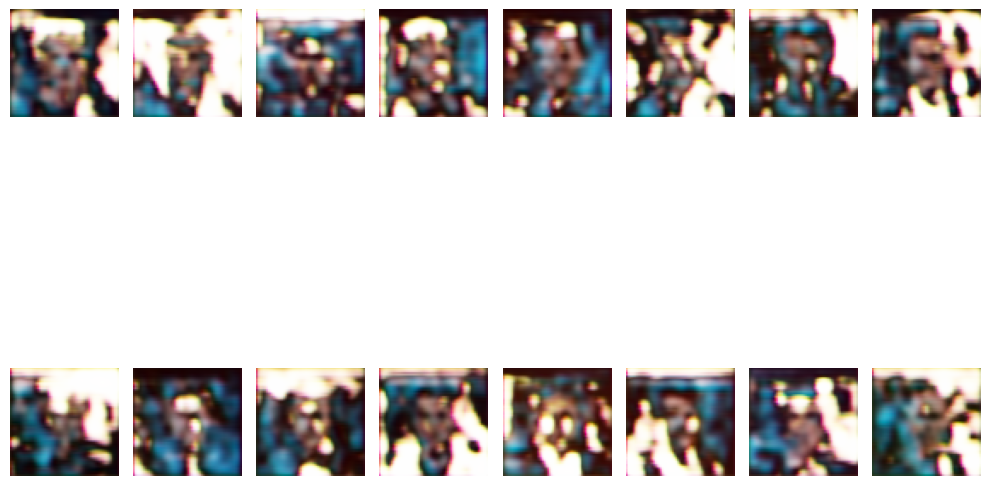

Epoch 5


batch 400/12 loss: 0.1537: 100%|██████████| 414/414 [00:55<00:00,  7.53it/s]


Plotting...


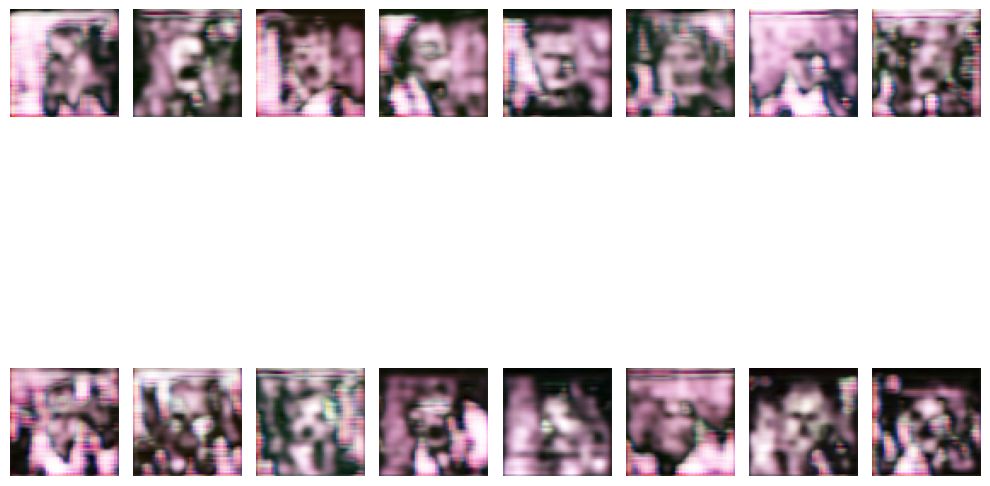

Epoch 6


batch 400/12 loss: 0.0413: 100%|██████████| 414/414 [00:52<00:00,  7.93it/s]


Plotting...


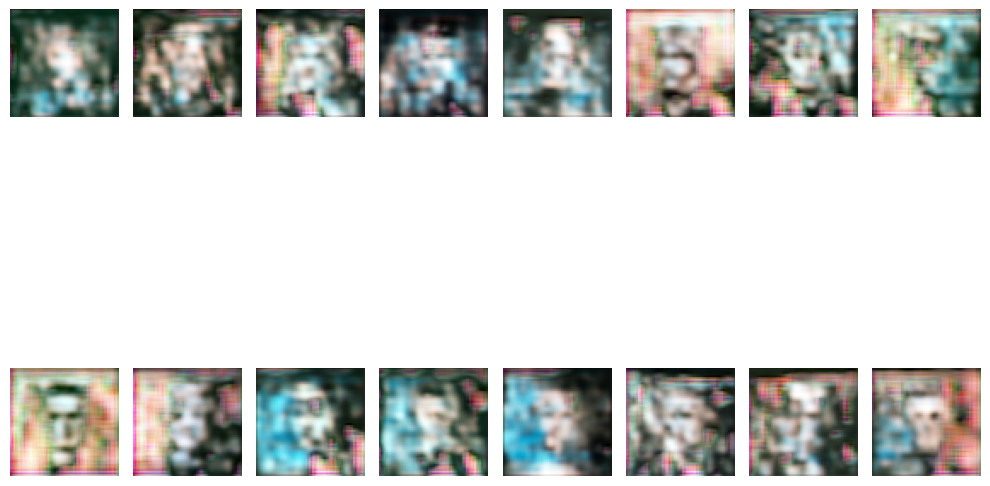

Epoch 7


batch 400/12 loss: 0.1855: 100%|██████████| 414/414 [00:51<00:00,  8.06it/s]


Plotting...


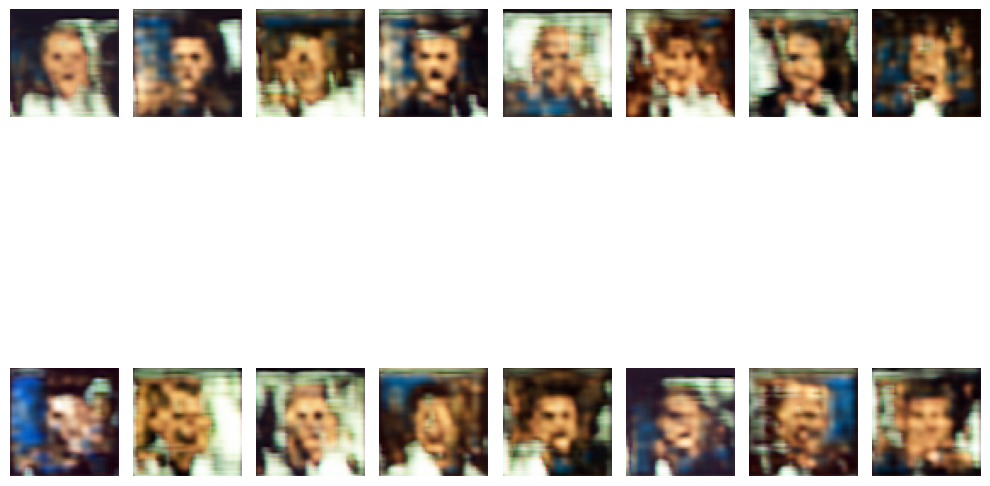

Epoch 8


batch 400/12 loss: 0.1379: 100%|██████████| 414/414 [00:50<00:00,  8.22it/s]


Plotting...


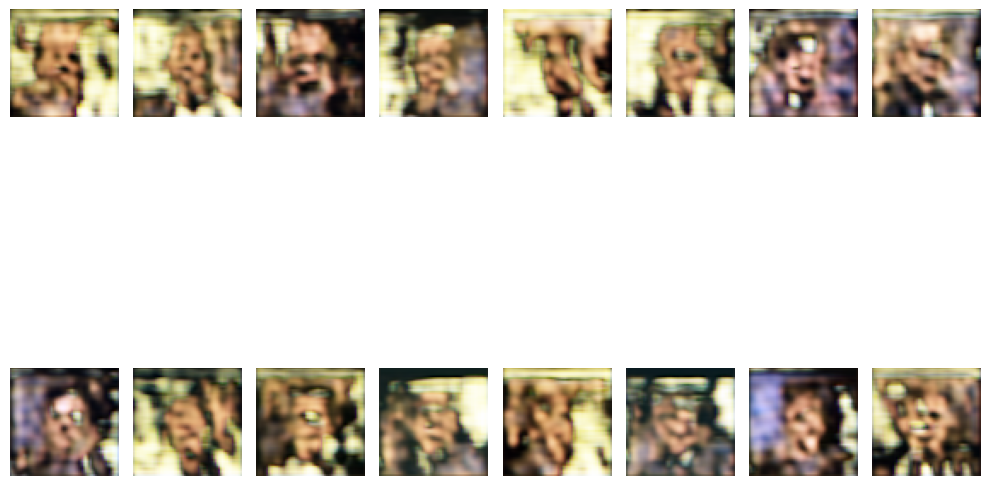

Epoch 9


batch 400/12 loss: 0.2205: 100%|██████████| 414/414 [00:57<00:00,  7.25it/s]


Plotting...


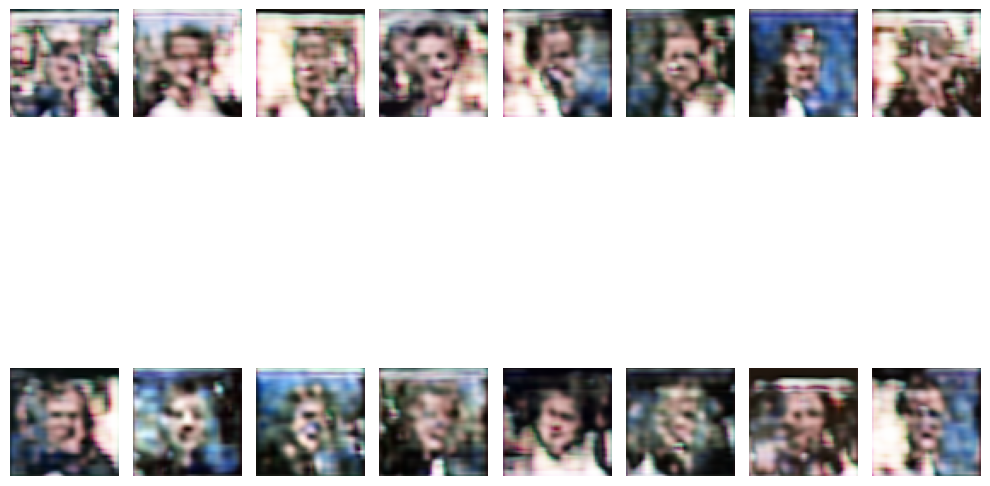

Epoch 10


batch 400/12 loss: 0.2515: 100%|██████████| 414/414 [00:59<00:00,  6.94it/s]


Plotting...


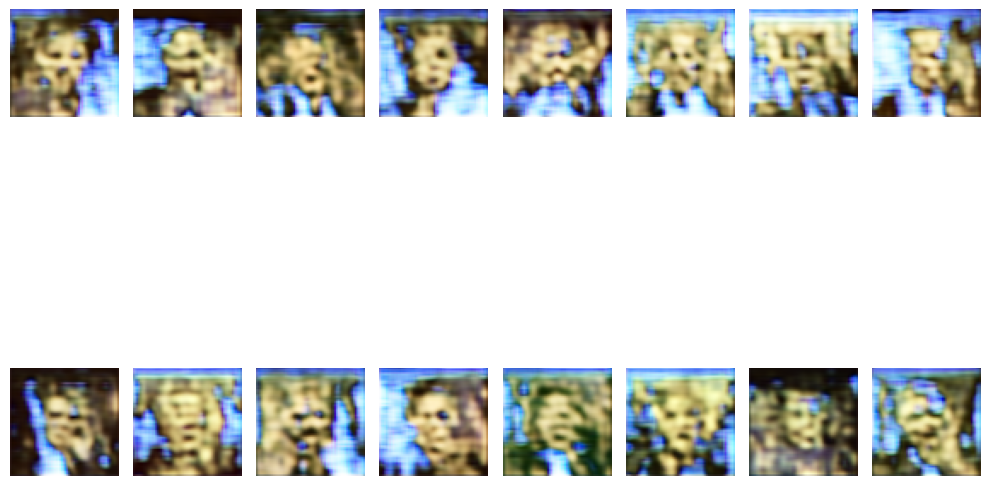

Epoch 11


batch 400/12 loss: 0.1993: 100%|██████████| 414/414 [01:00<00:00,  6.82it/s]


Plotting...


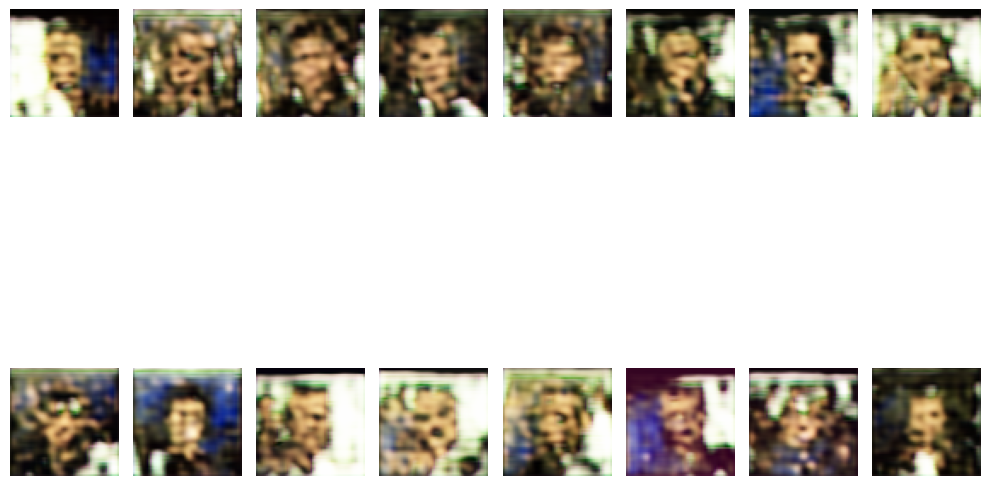

Epoch 12


batch 400/12 loss: 0.1348: 100%|██████████| 414/414 [00:52<00:00,  7.84it/s]


Plotting...


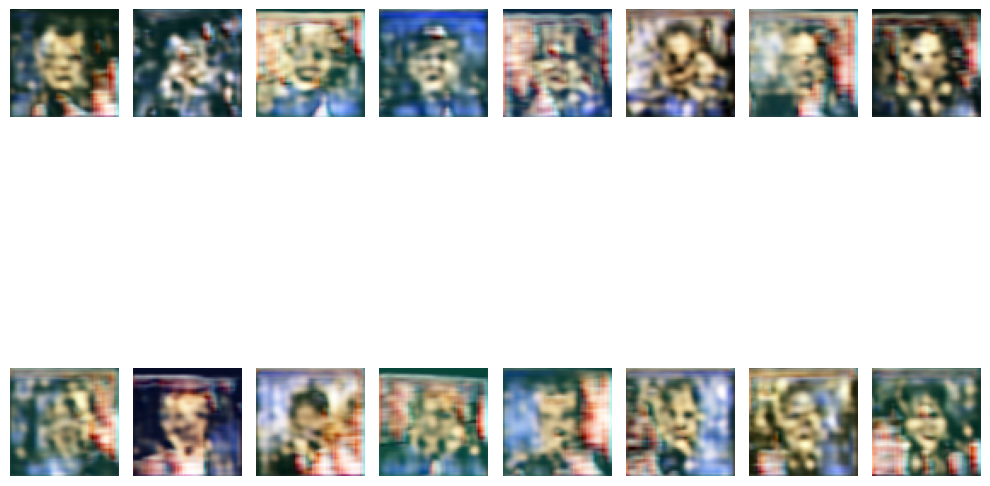

Epoch 13


batch 400/12 loss: 0.0296: 100%|██████████| 414/414 [00:56<00:00,  7.37it/s]


Plotting...


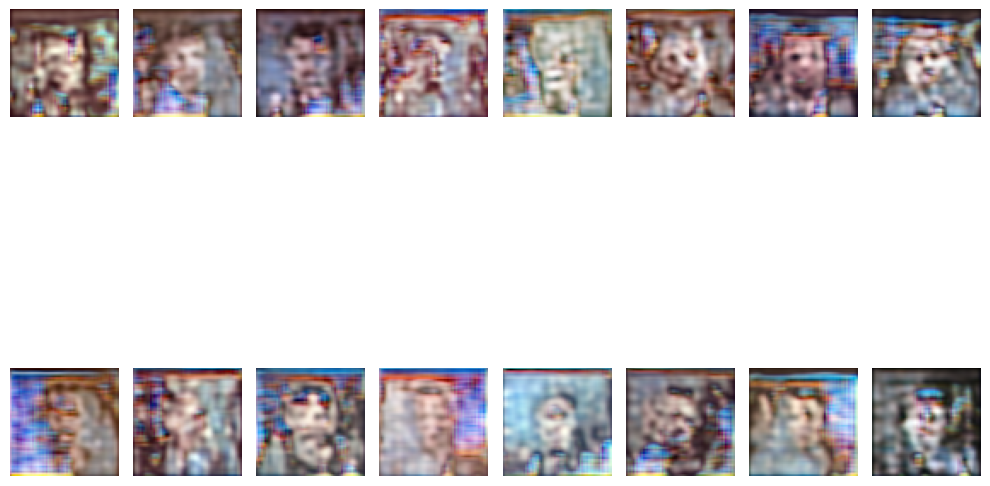

Epoch 14


batch 400/12 loss: 0.1900: 100%|██████████| 414/414 [01:01<00:00,  6.78it/s]


Plotting...


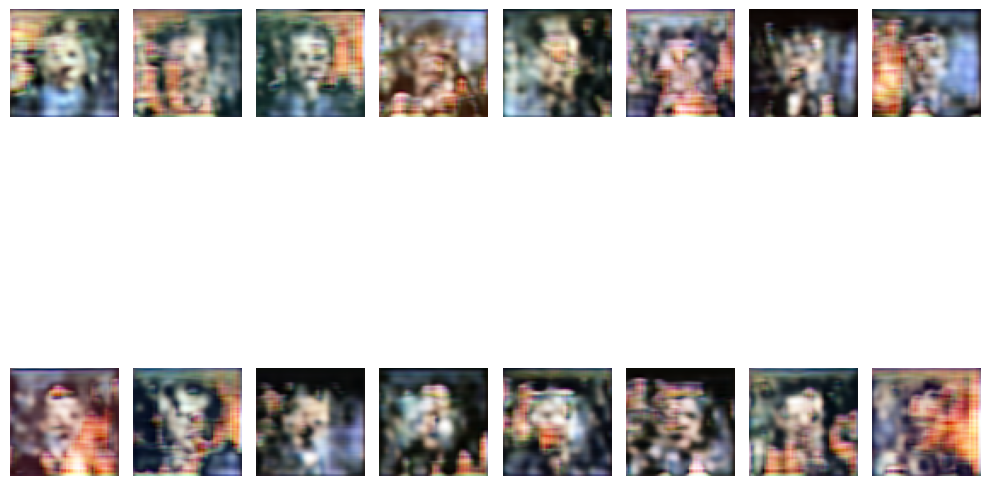

Epoch 15


batch 400/12 loss: 0.1837: 100%|██████████| 414/414 [01:06<00:00,  6.25it/s]


Plotting...


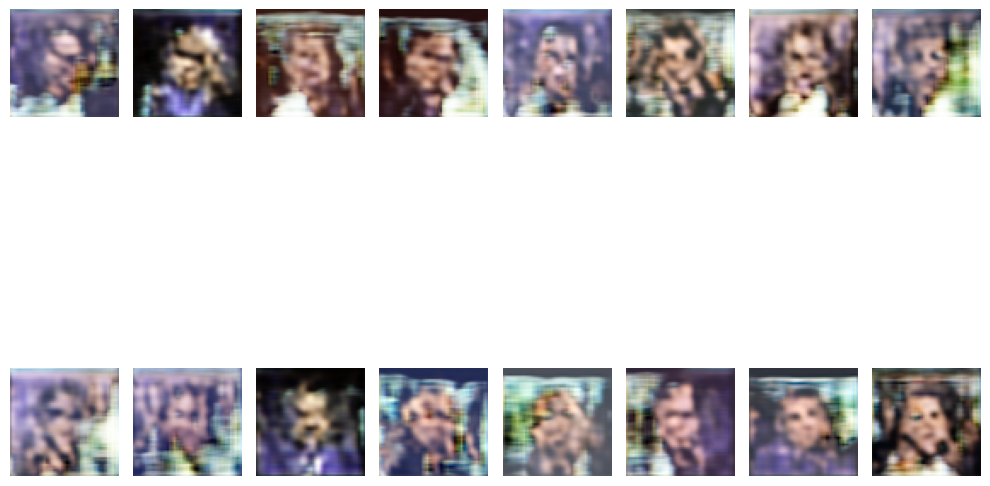

Epoch 16


batch 400/12 loss: 0.1140: 100%|██████████| 414/414 [00:54<00:00,  7.53it/s]


Plotting...


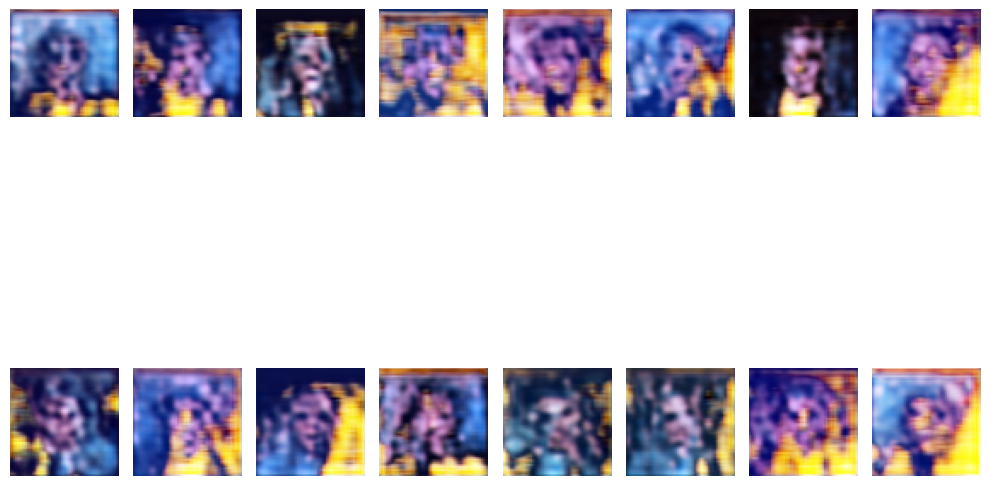

Epoch 17


batch 400/12 loss: 0.0976: 100%|██████████| 414/414 [00:59<00:00,  7.01it/s]


Plotting...


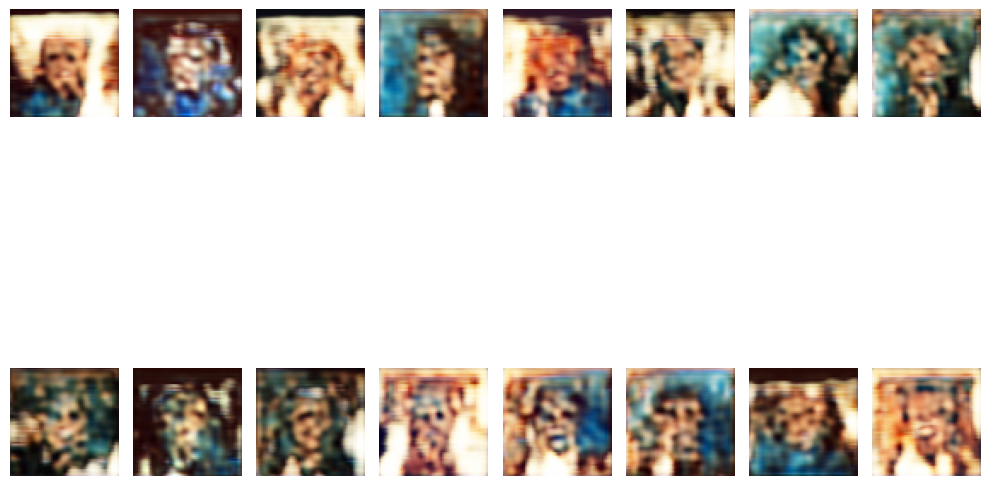

Epoch 18


batch 400/12 loss: 0.2065: 100%|██████████| 414/414 [01:01<00:00,  6.75it/s]


Plotting...


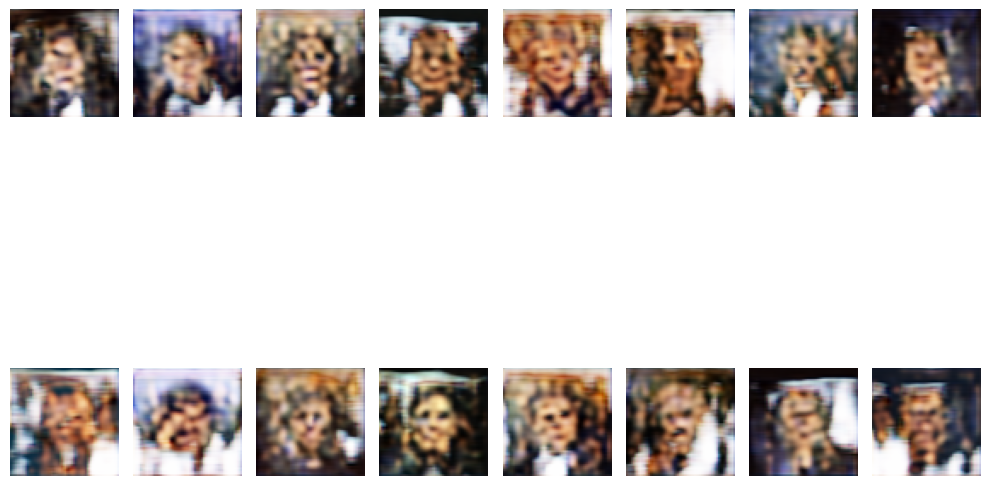

Epoch 19


batch 400/12 loss: 0.1614: 100%|██████████| 414/414 [00:59<00:00,  6.96it/s]


Plotting...


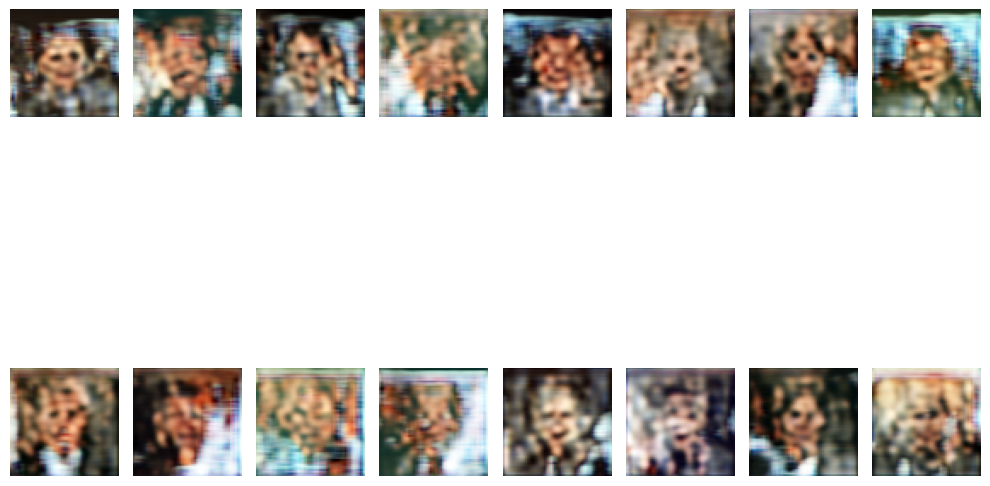

Epoch 20


batch 400/12 loss: 0.1877: 100%|██████████| 414/414 [00:59<00:00,  6.93it/s]


Plotting...


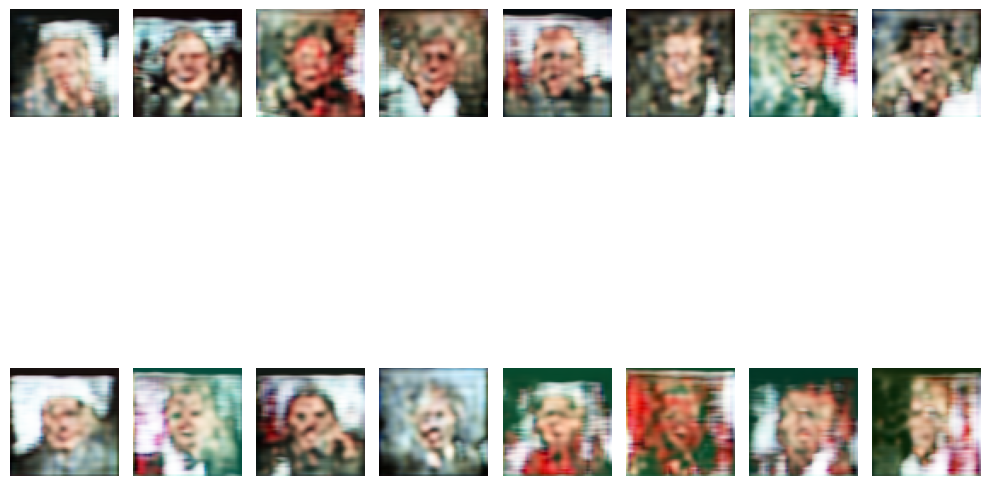

Epoch 21


batch 400/12 loss: 0.1640: 100%|██████████| 414/414 [01:04<00:00,  6.40it/s]


Plotting...


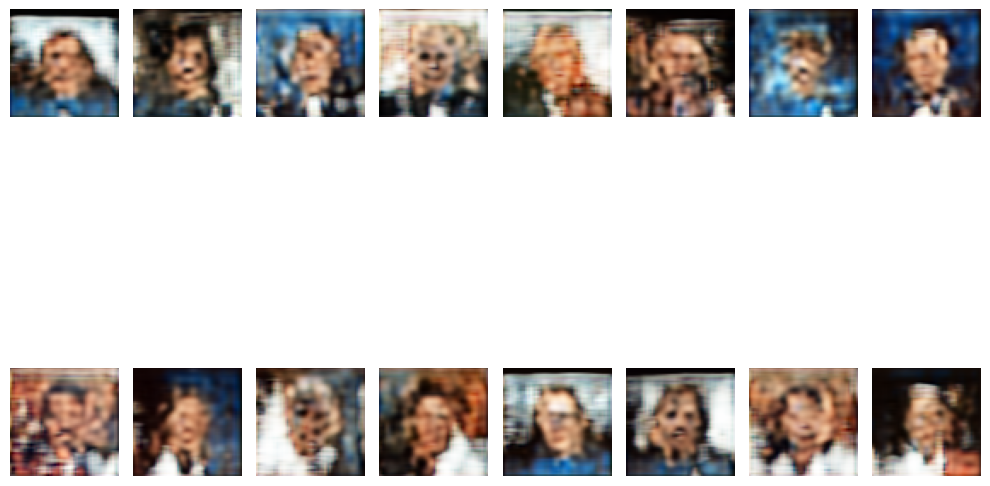

Epoch 22


batch 400/12 loss: 0.2363: 100%|██████████| 414/414 [01:02<00:00,  6.61it/s]


Plotting...


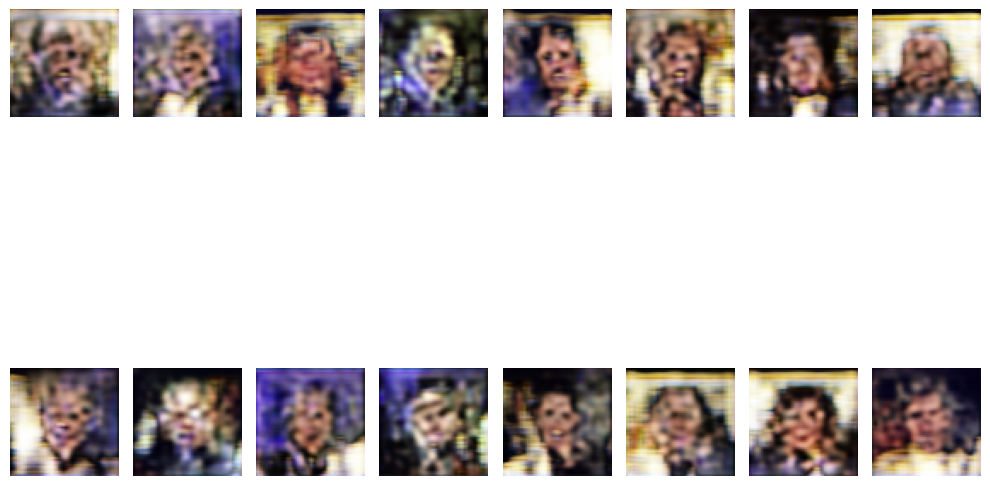

Epoch 23


batch 400/12 loss: 0.1390: 100%|██████████| 414/414 [00:58<00:00,  7.04it/s]


Plotting...


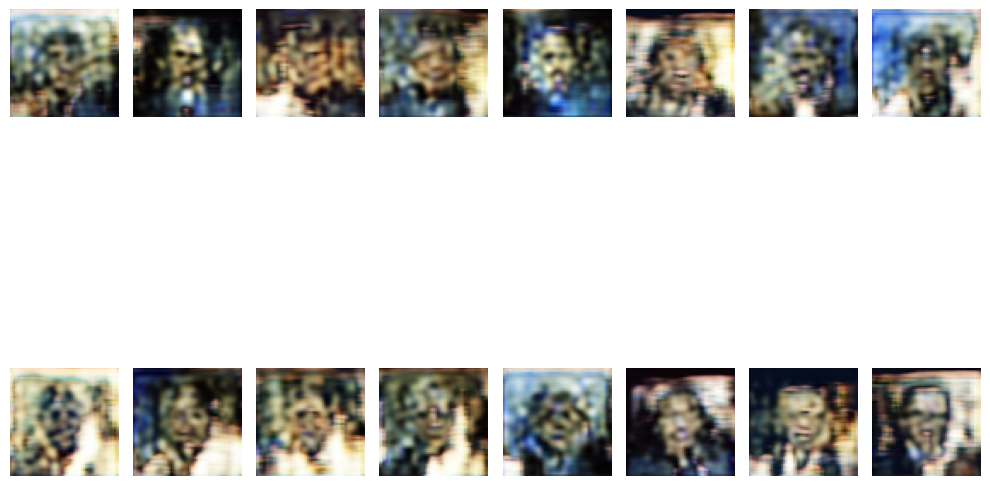

Epoch 24


batch 400/12 loss: 0.2819: 100%|██████████| 414/414 [01:01<00:00,  6.76it/s]


Plotting...


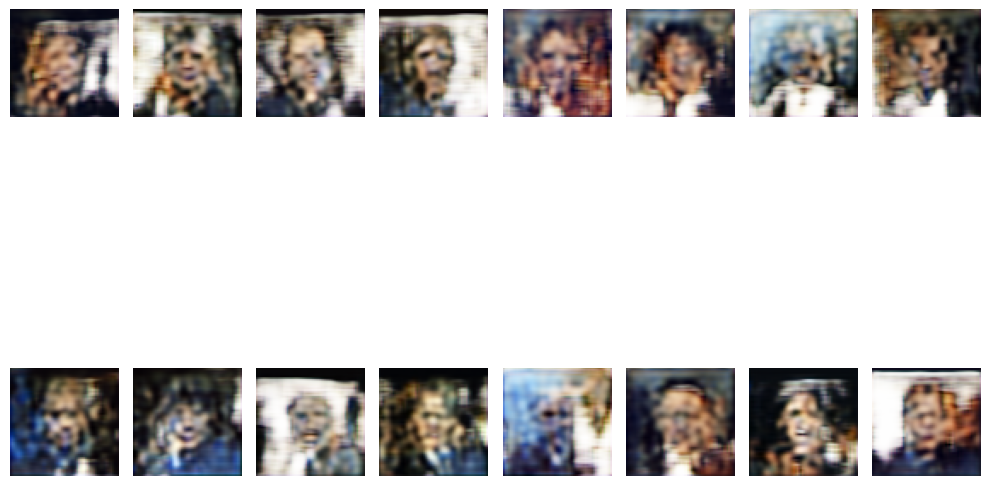

Epoch 25


batch 400/12 loss: 0.2366: 100%|██████████| 414/414 [01:04<00:00,  6.38it/s]


Plotting...


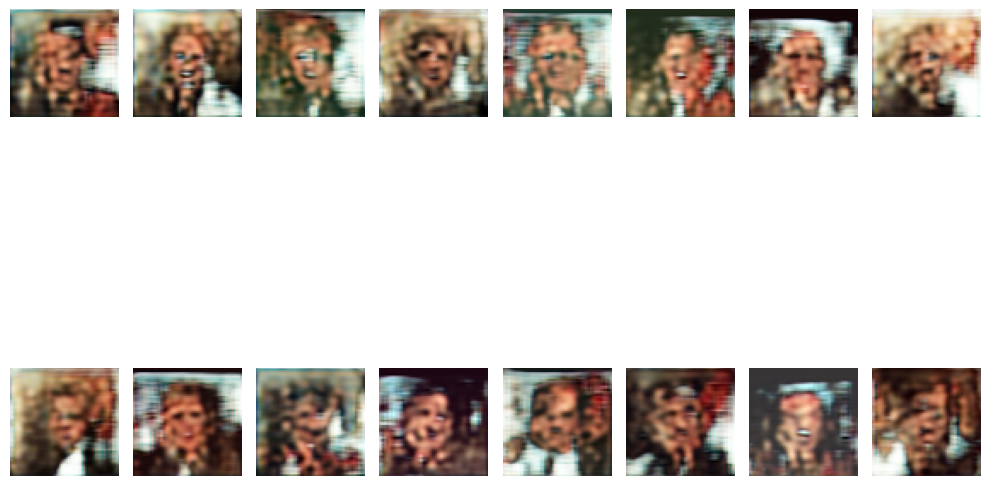

Epoch 26


batch 400/12 loss: 0.1138: 100%|██████████| 414/414 [01:03<00:00,  6.53it/s]


Plotting...


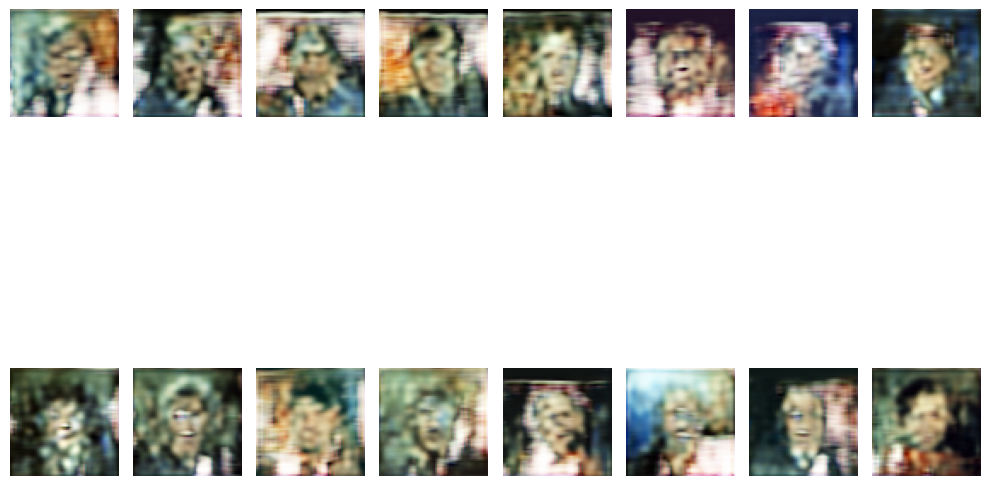

Epoch 27


batch 400/12 loss: 0.0824: 100%|██████████| 414/414 [01:01<00:00,  6.77it/s]


Plotting...


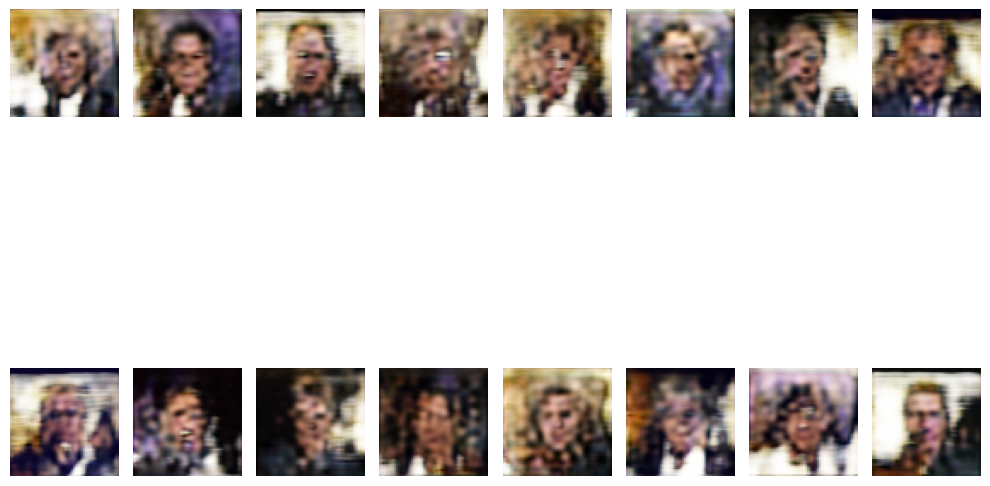

Epoch 28


batch 400/12 loss: 0.0697: 100%|██████████| 414/414 [01:05<00:00,  6.34it/s]


Plotting...


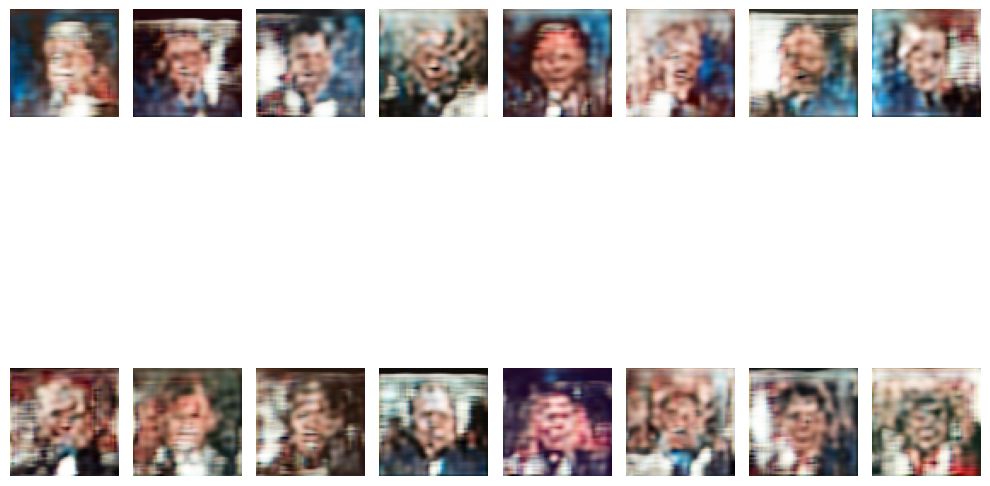

Epoch 29


batch 400/12 loss: 0.2526: 100%|██████████| 414/414 [01:06<00:00,  6.26it/s]


Plotting...


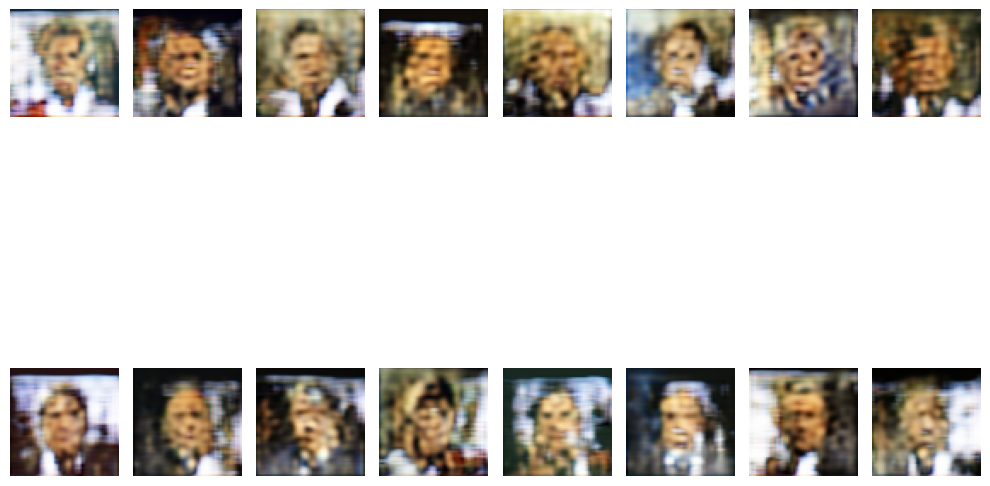

Epoch 30


batch 400/12 loss: 0.1261: 100%|██████████| 414/414 [01:06<00:00,  6.25it/s]


Plotting...


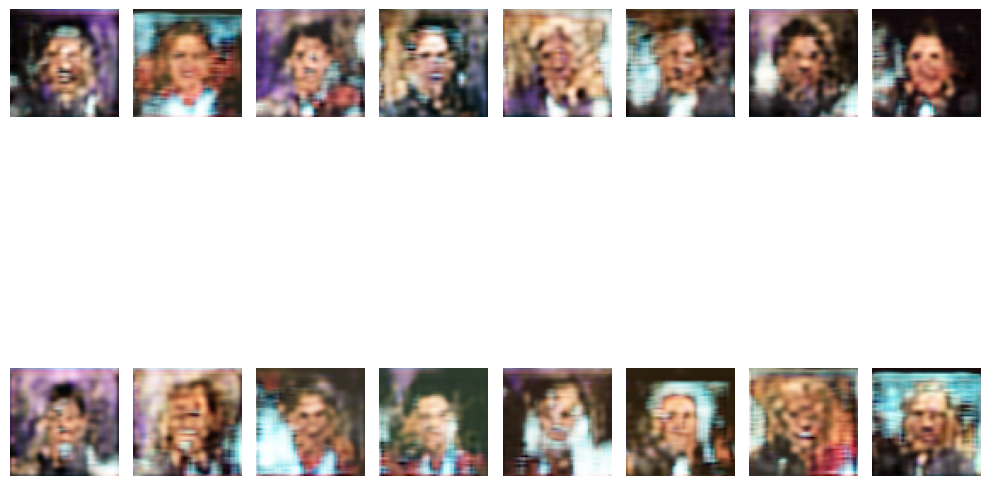

Epoch 31


batch 400/12 loss: 0.1367: 100%|██████████| 414/414 [01:02<00:00,  6.67it/s]


Plotting...


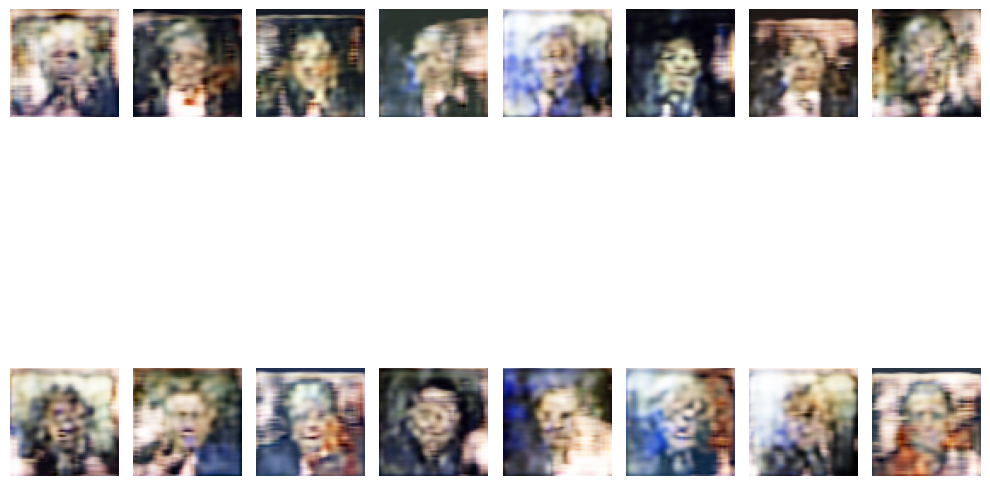

Epoch 32


batch 400/12 loss: 0.1622: 100%|██████████| 414/414 [01:11<00:00,  5.79it/s]


Plotting...


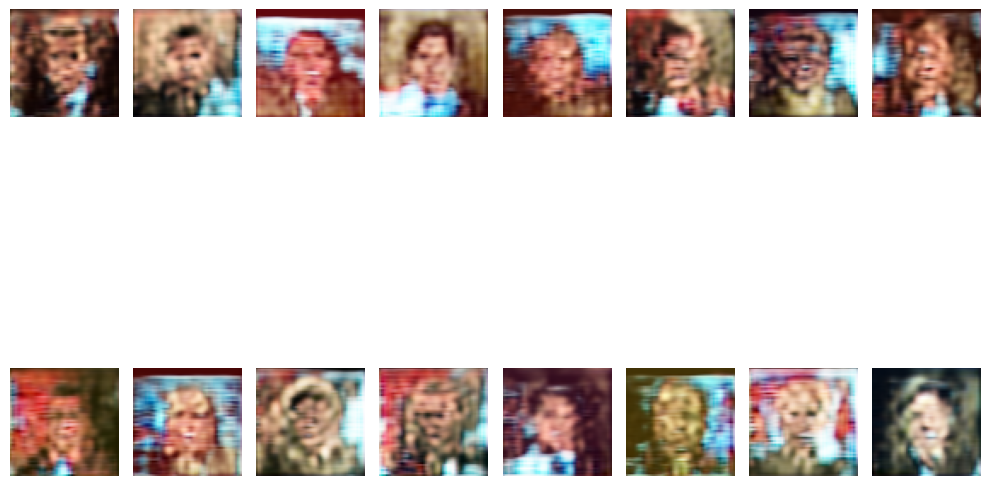

Epoch 33


batch 400/12 loss: 0.1042: 100%|██████████| 414/414 [01:04<00:00,  6.39it/s]


Plotting...


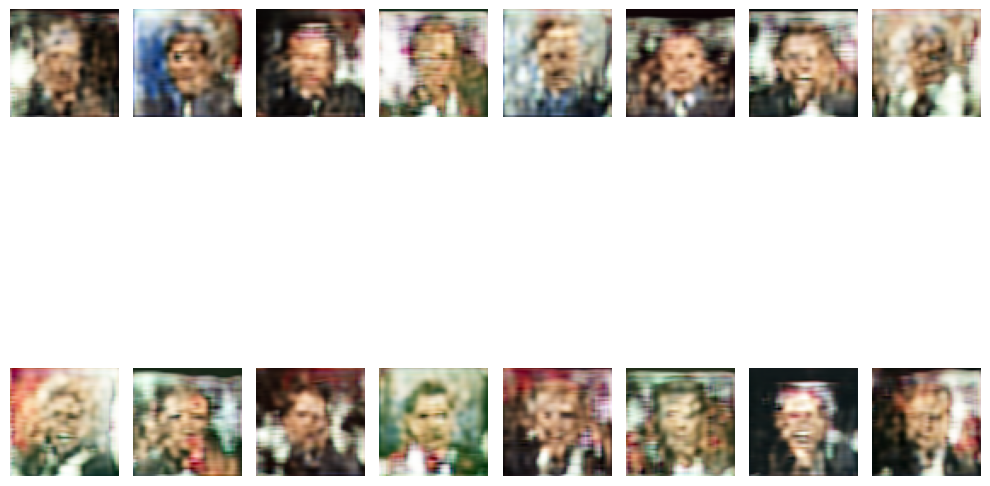

Epoch 34


batch 400/12 loss: 0.0892: 100%|██████████| 414/414 [01:07<00:00,  6.14it/s]


Plotting...


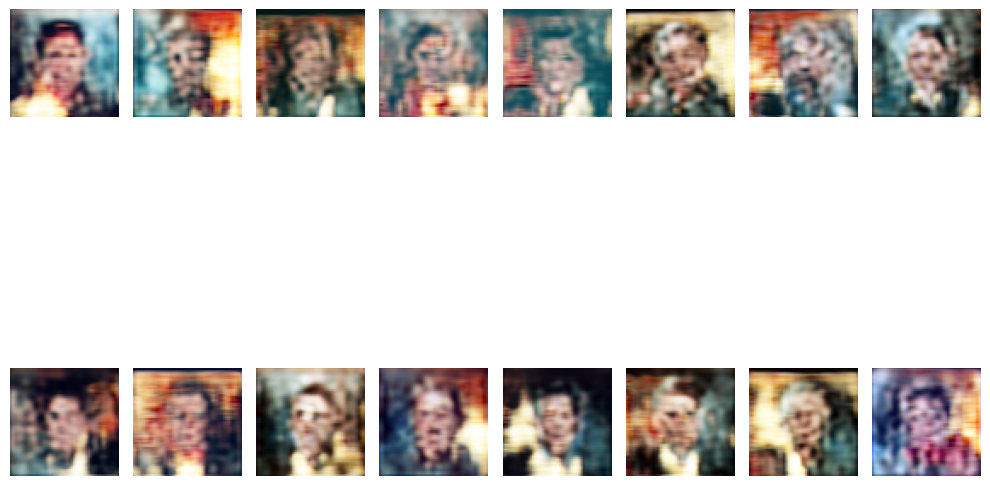

Epoch 35


batch 400/12 loss: 0.0072: 100%|██████████| 414/414 [01:08<00:00,  6.05it/s]


Plotting...


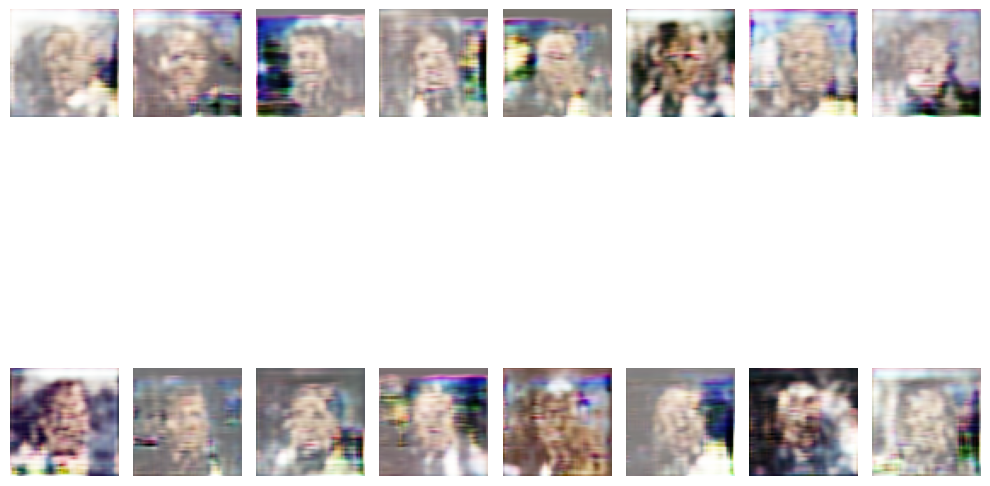

Epoch 36


batch 400/12 loss: 0.0468: 100%|██████████| 414/414 [01:11<00:00,  5.80it/s]


Plotting...


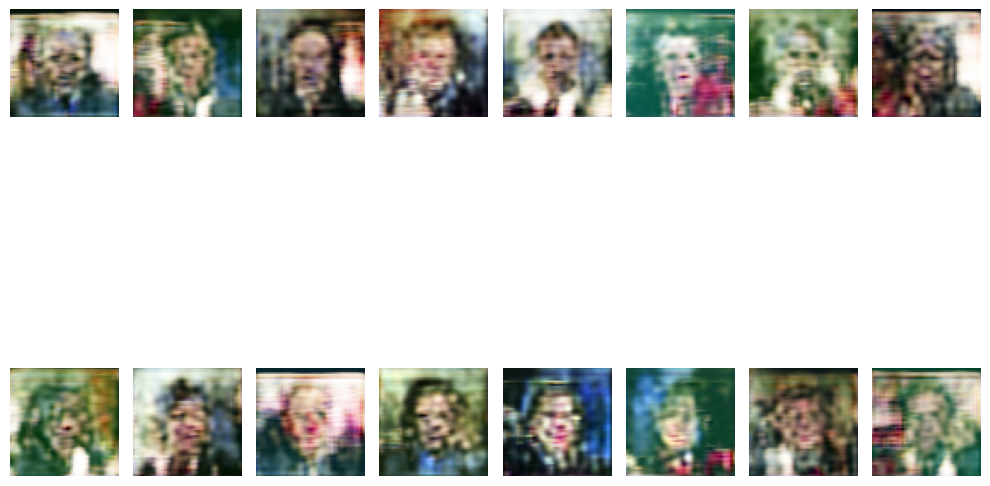

Epoch 37


batch 400/12 loss: 0.2164: 100%|██████████| 414/414 [01:08<00:00,  6.03it/s]


Plotting...


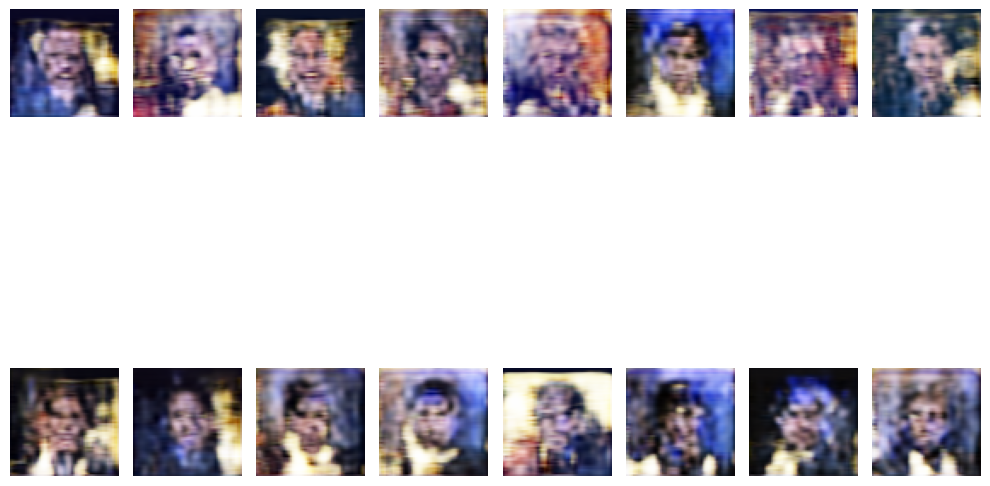

Epoch 38


batch 400/12 loss: 0.1149: 100%|██████████| 414/414 [01:08<00:00,  6.01it/s]


Plotting...


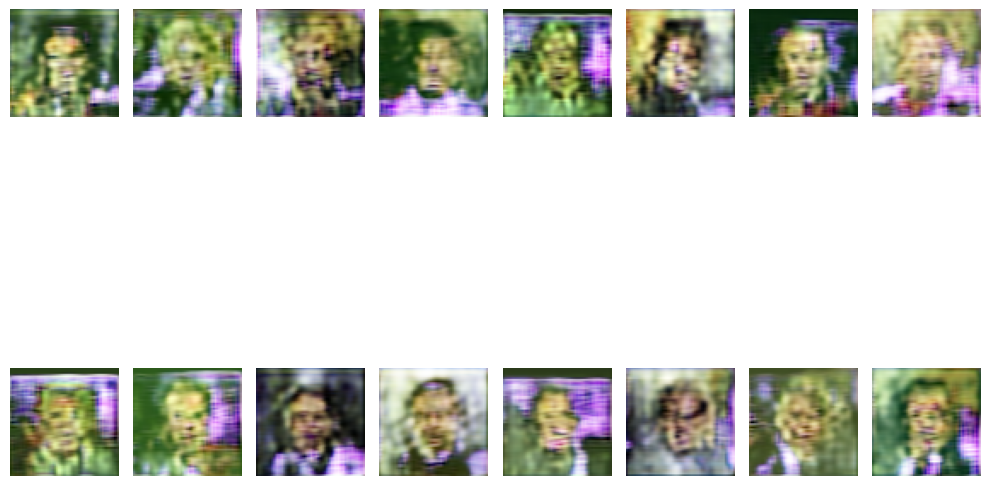

Epoch 39


batch 400/12 loss: 0.1639: 100%|██████████| 414/414 [01:16<00:00,  5.43it/s]


Plotting...


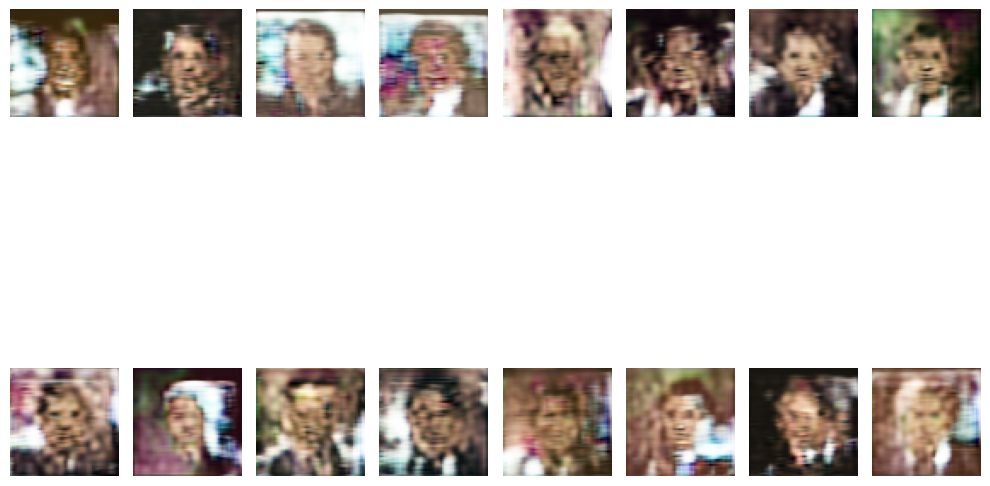

Epoch 40


batch 400/12 loss: 0.0781: 100%|██████████| 414/414 [01:11<00:00,  5.77it/s]


Plotting...


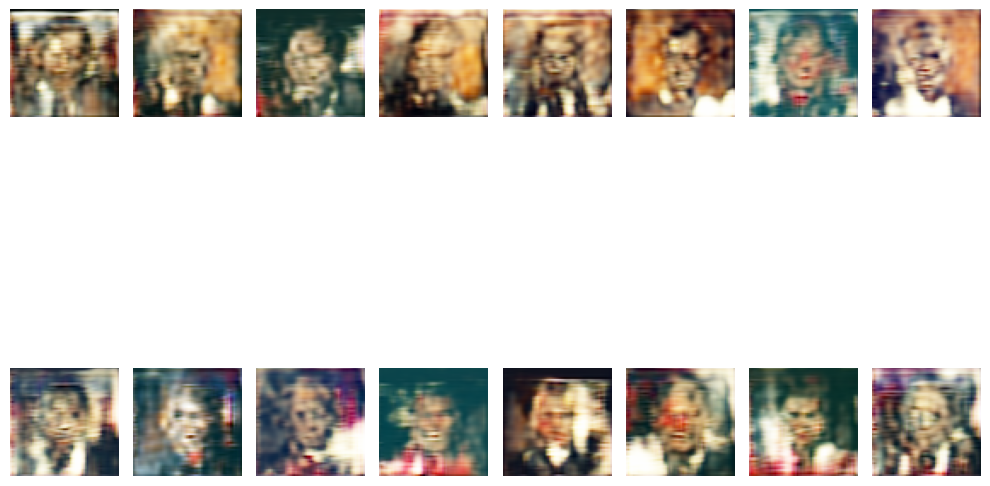

Epoch 41


batch 400/12 loss: 0.0790: 100%|██████████| 414/414 [01:10<00:00,  5.86it/s]


Plotting...


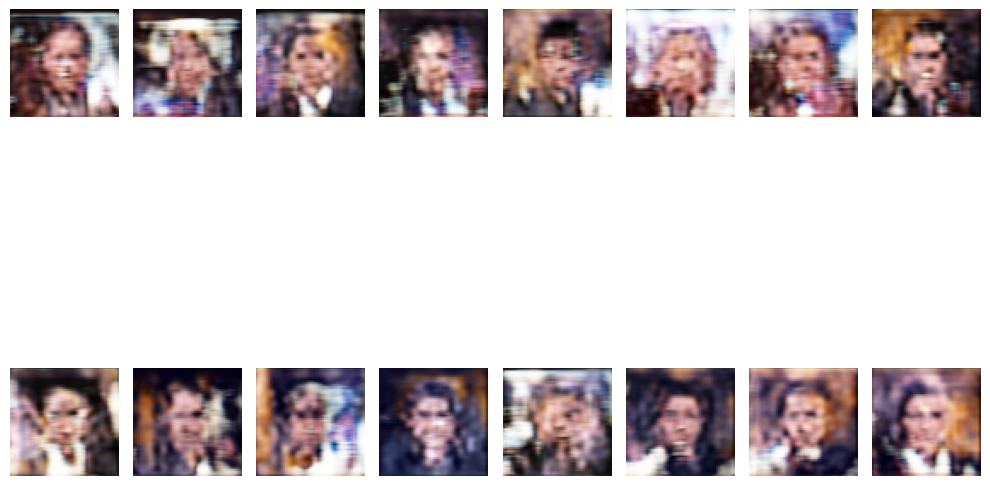

Epoch 42


batch 400/12 loss: 0.1415: 100%|██████████| 414/414 [01:15<00:00,  5.51it/s]


Plotting...


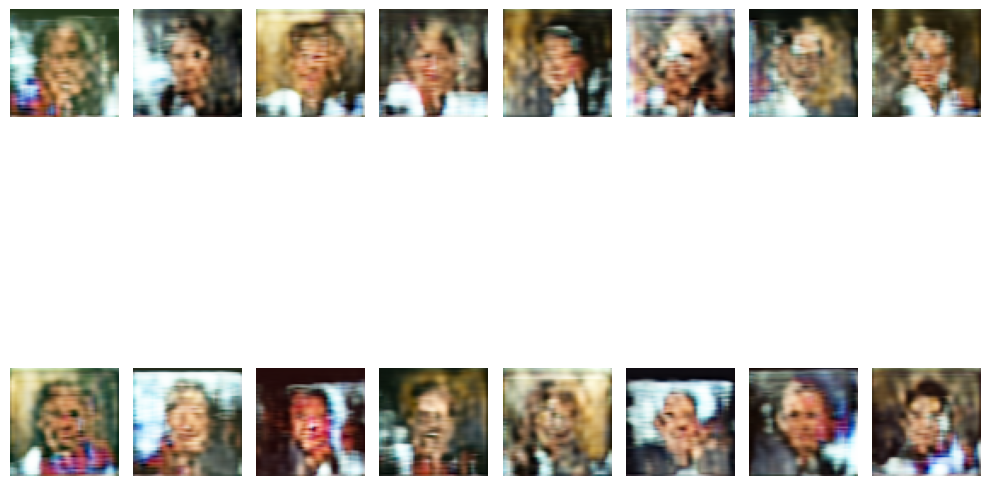

Epoch 43


batch 400/12 loss: 0.1307: 100%|██████████| 414/414 [01:12<00:00,  5.74it/s]


Plotting...


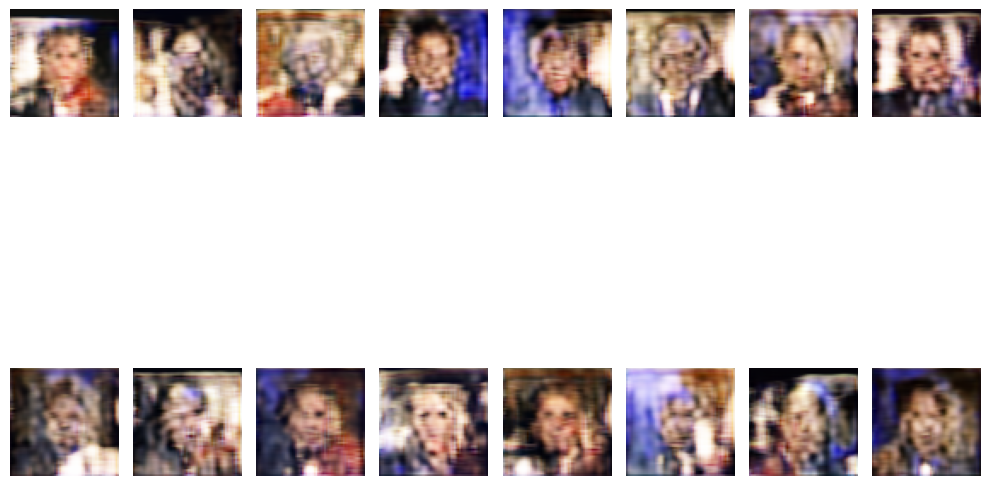

Epoch 44


batch 400/12 loss: 0.1447: 100%|██████████| 414/414 [01:11<00:00,  5.83it/s]


Plotting...


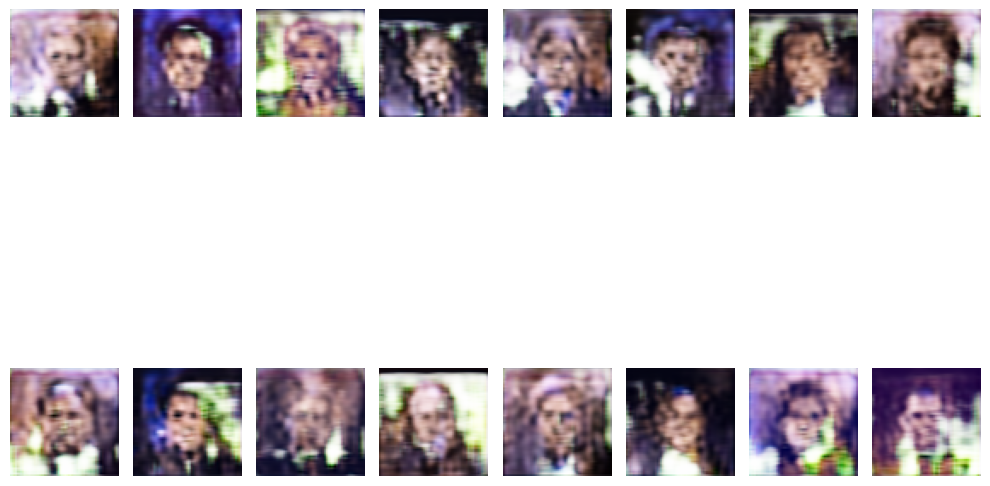

Epoch 45


batch 400/12 loss: 0.1199: 100%|██████████| 414/414 [01:14<00:00,  5.52it/s]


Plotting...


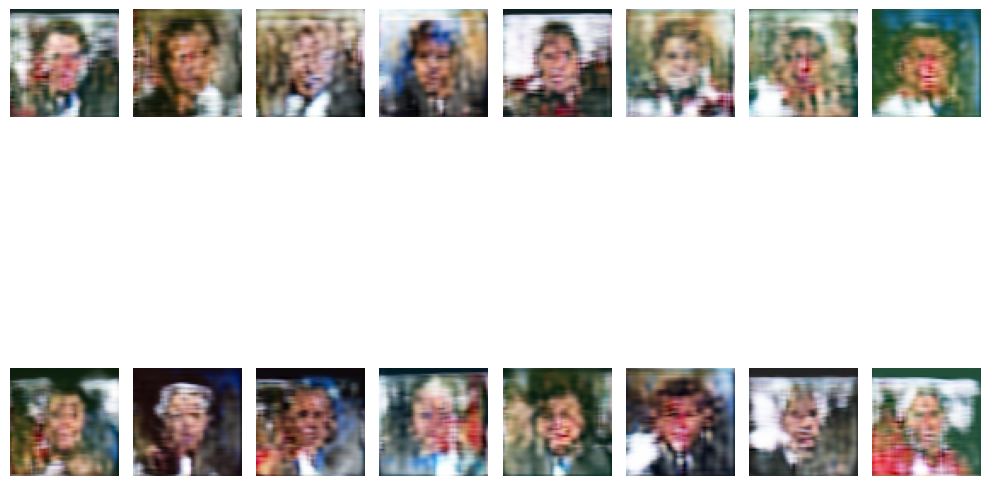

Epoch 46


batch 400/12 loss: 0.0751: 100%|██████████| 414/414 [01:13<00:00,  5.61it/s]


Plotting...


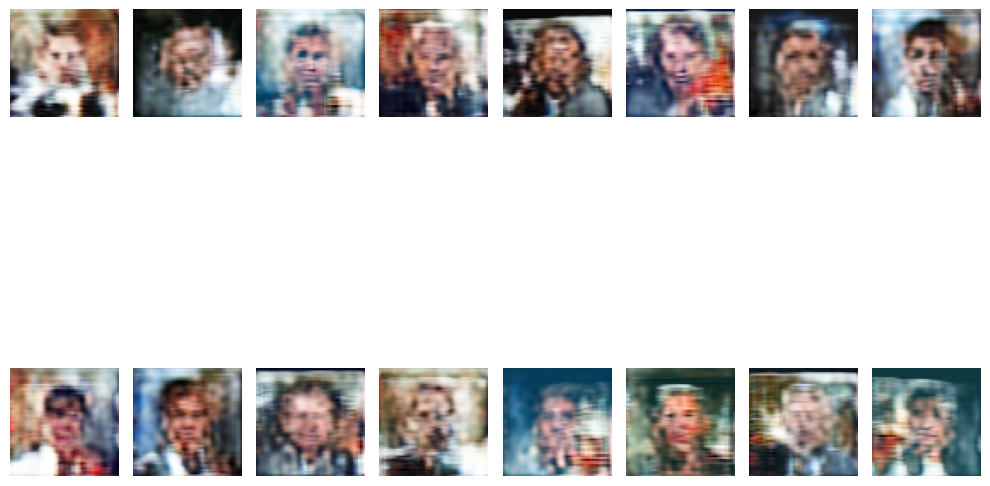

Epoch 47


batch 400/12 loss: 0.0733: 100%|██████████| 414/414 [01:12<00:00,  5.72it/s]


Plotting...


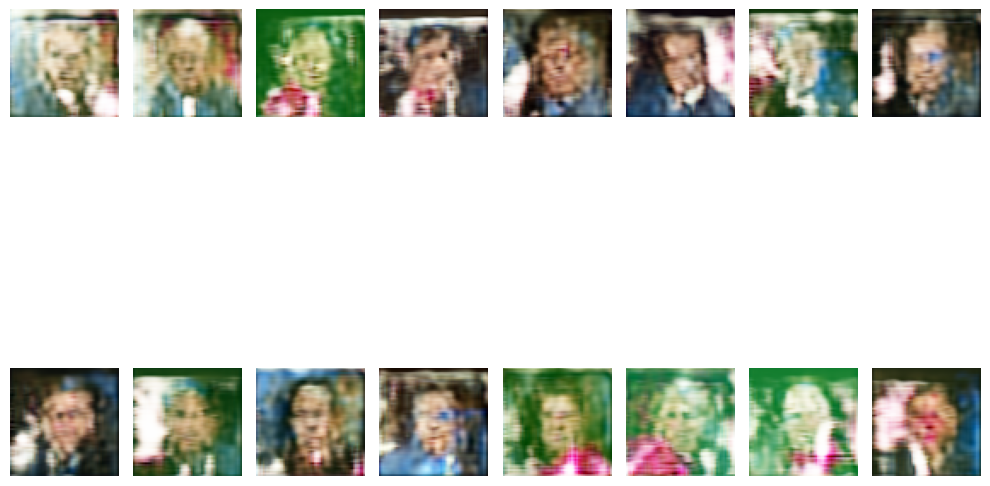

Epoch 48


batch 400/12 loss: 0.1128: 100%|██████████| 414/414 [01:14<00:00,  5.59it/s]


Plotting...


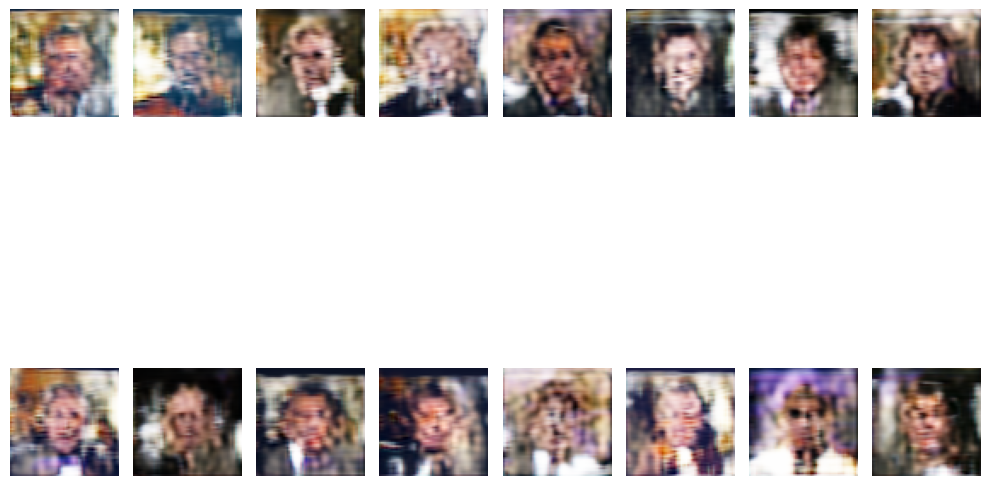

Epoch 49


batch 400/12 loss: 0.1015: 100%|██████████| 414/414 [01:12<00:00,  5.74it/s]


Plotting...


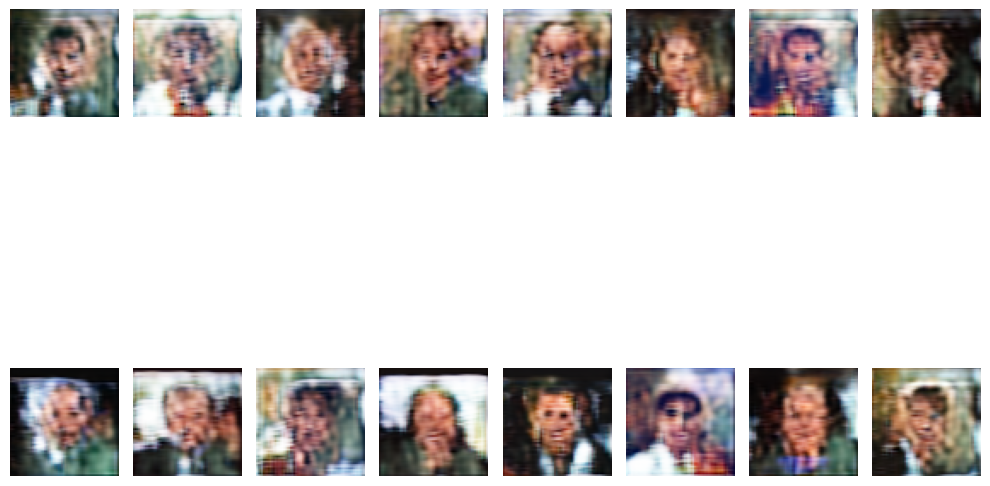

Epoch 50


batch 400/12 loss: 0.1090: 100%|██████████| 414/414 [01:14<00:00,  5.58it/s]


Plotting...


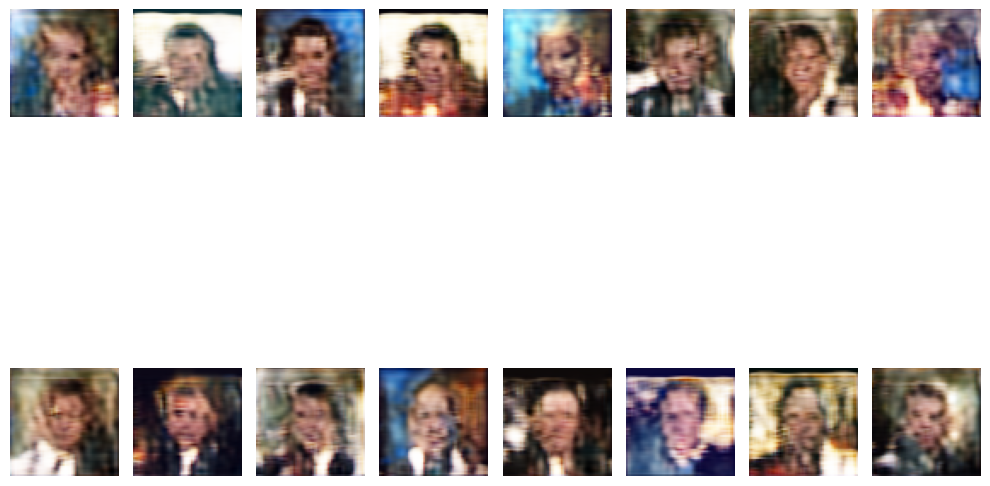

Epoch 51


batch 400/12 loss: 0.1260: 100%|██████████| 414/414 [01:12<00:00,  5.73it/s]


Plotting...


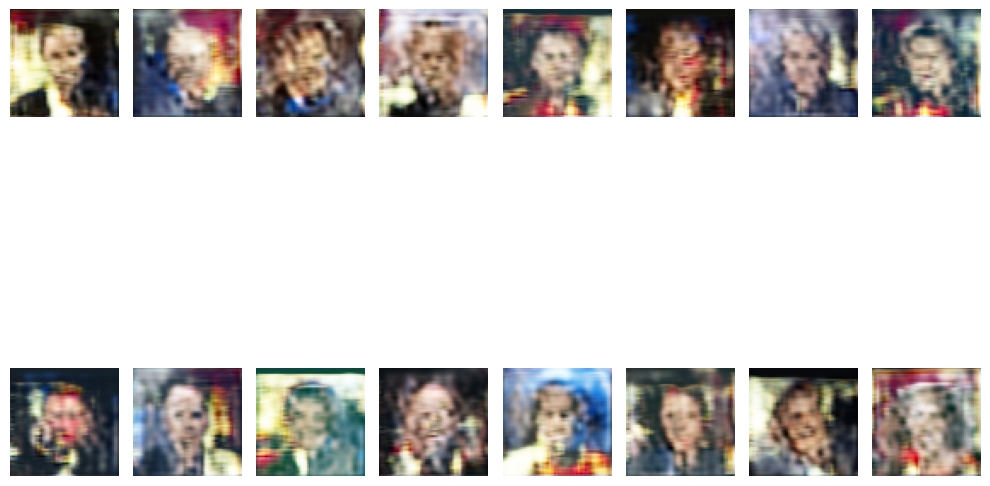

Epoch 52


batch 400/12 loss: 0.1080: 100%|██████████| 414/414 [01:13<00:00,  5.64it/s]


Plotting...


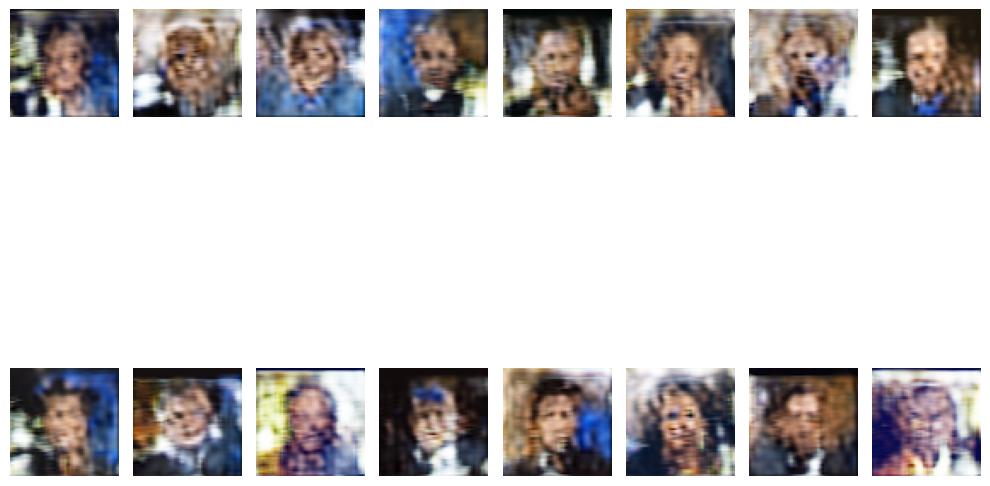

Epoch 53


batch 400/12 loss: 0.1057: 100%|██████████| 414/414 [01:10<00:00,  5.83it/s]


Plotting...


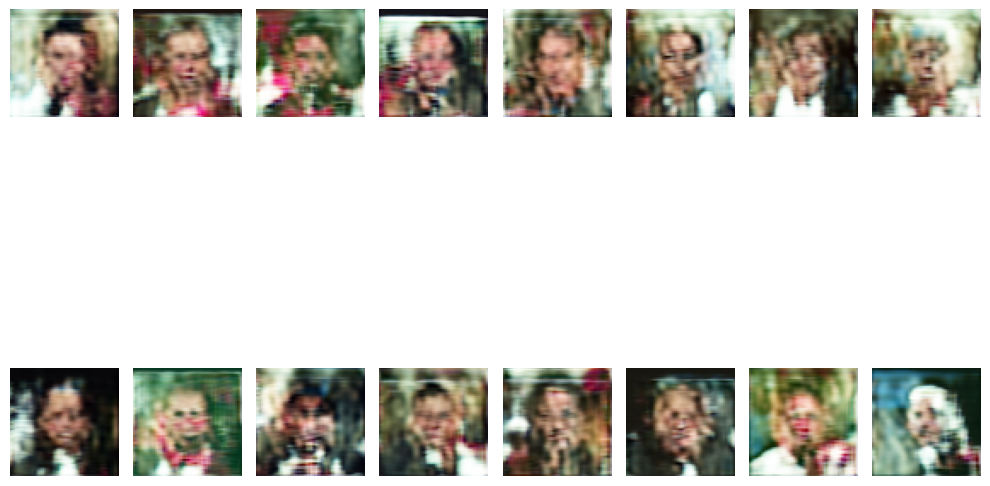

Epoch 54


batch 400/12 loss: 0.1124: 100%|██████████| 414/414 [01:13<00:00,  5.65it/s]


Plotting...


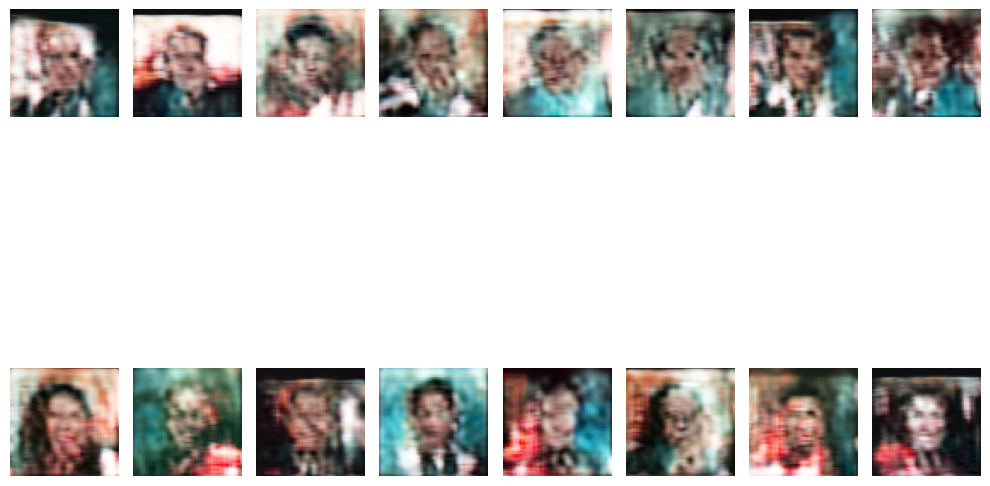

Epoch 55


batch 400/12 loss: 0.1109: 100%|██████████| 414/414 [01:12<00:00,  5.67it/s]


Plotting...


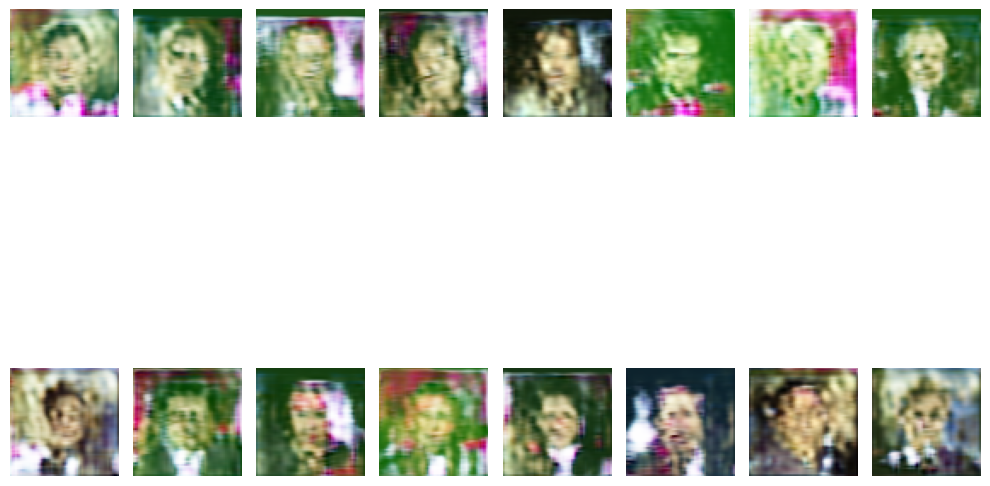

Epoch 56


batch 400/12 loss: 0.0635: 100%|██████████| 414/414 [01:12<00:00,  5.68it/s]


Plotting...


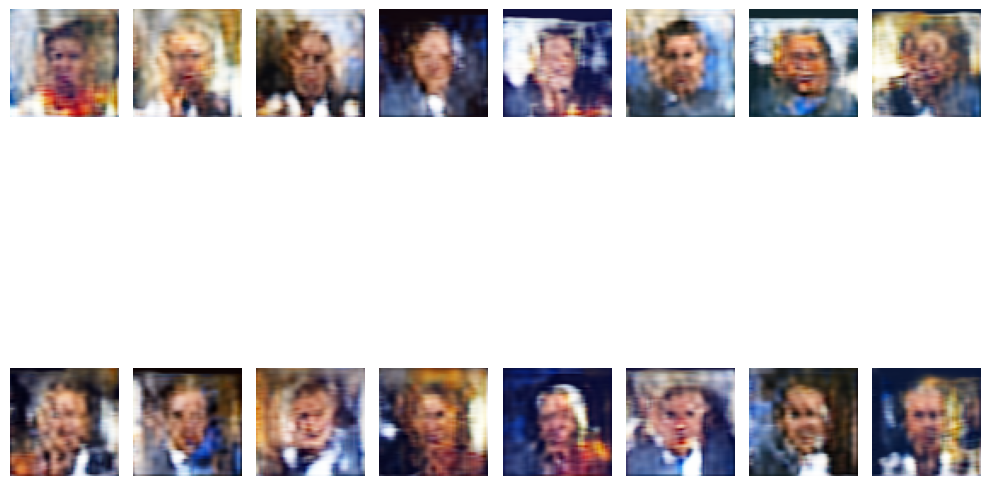

Epoch 57


batch 400/12 loss: 0.0909: 100%|██████████| 414/414 [01:13<00:00,  5.64it/s]


Plotting...


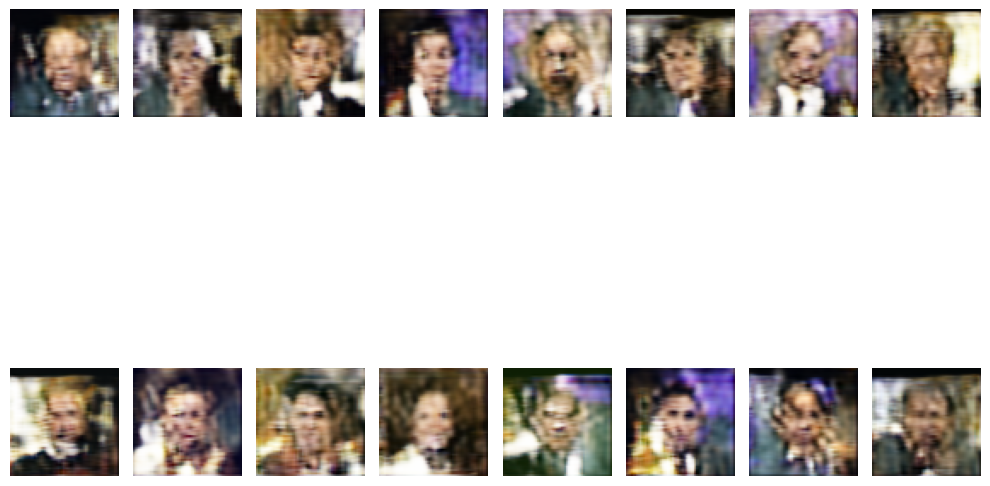

Epoch 58


batch 400/12 loss: 0.1211: 100%|██████████| 414/414 [01:15<00:00,  5.52it/s]


Plotting...


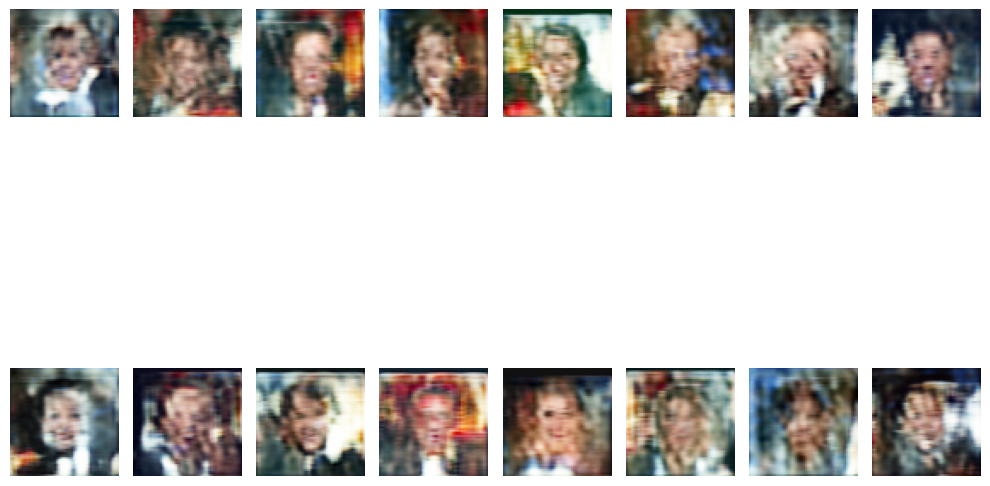

Epoch 59


batch 400/12 loss: 0.2457: 100%|██████████| 414/414 [01:11<00:00,  5.77it/s]


Plotting...


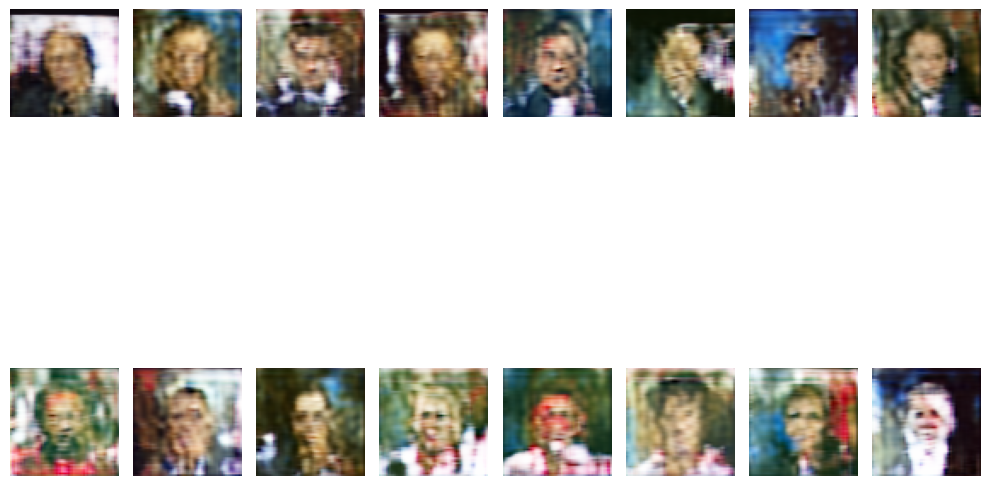

Epoch 60


batch 128/12 loss: 0.1469:  30%|███       | 125/414 [00:24<01:02,  4.62it/s]

In [ ]:
trainer = GAN()
loader = torch.utils.data.DataLoader(
             ds,
             batch_size=batch_size,
             shuffle=True,
             num_workers=12,
             persistent_workers=True)

trainer.fit(loader, callbacks=[plot, save_model])